# SENTIMENTAL ANALYSIS FOR COVID-19 VACINE
<img src='images.jpg' style="width:900px;height:500px"/>

<h3 style = "font-family: cursive;background-color:#ff99cc	">INTRODUCTION </h3>
 
- The COVID-19 outbreak has brought significant attention to the healthcare sector in recent times, and it has changed the concept of safety in every aspect of our lives. Social distancing is an effective method for reducing the spread of coronavirus. Safety measures such as wearing masks, washing hands regularly, and staying careful regarding intimacy

<h3 style = "font-family: cursive;background-color:#ff99cc	"> Problem Statement</h3>

- The main aim is to understand the diverse sentiments of people regarding the vaccination process.

<h3 style = "font-family: cursive;background-color:#ff99cc	">Dataset Information </h3>

- The dataset named “All COVID-19 Vaccines Tweets” from Kaggle [link](https://www.kaggle.com/gpreda/all-covid19-vaccines-tweets) was chosen in this research where the data of almost all the renowned vaccines, such as Pfizer/ BioNTech, Oxford/AstraZeneca, Moderna, Covaxin, Sputnik V, Sinopharm, and Sinovac, are available. 
- Here, the dataset shape is 185964 by 16, including username, date,location, number of friends, retweets, hashtags, and source

<h3 style = "font-family: cursive;background-color:#ff99cc	">Loading and Checking the dataset: </h3>

In [43]:
# load the packages 
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import plotly.express as px
import neattext as ntx
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from collections import Counter
from textblob import TextBlob

In [44]:
# load the dataset
path='vaccination_all_tweets.csv'
data= pd.read_csv(path)

In [45]:
#check the dataset columns
print(data.columns)

Index(['id', 'user_name', 'user_location', 'user_description', 'user_created',
       'user_followers', 'user_friends', 'user_favourites', 'user_verified',
       'date', 'text', 'hashtags', 'source', 'retweets', 'favorites',
       'is_retweet'],
      dtype='object')


In [46]:
# display the dimesions of the dataset
data.shape  

(228207, 16)

**Observation**
- The dataset has 185694 rows and 16 attributes

In [47]:
# display the dataset info.
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 228207 entries, 0 to 228206
Data columns (total 16 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   id                228207 non-null  int64 
 1   user_name         228205 non-null  object
 2   user_location     161296 non-null  object
 3   user_description  211189 non-null  object
 4   user_created      228207 non-null  object
 5   user_followers    228207 non-null  int64 
 6   user_friends      228207 non-null  int64 
 7   user_favourites   228207 non-null  int64 
 8   user_verified     228207 non-null  bool  
 9   date              228207 non-null  object
 10  text              228207 non-null  object
 11  hashtags          178504 non-null  object
 12  source            228088 non-null  object
 13  retweets          228207 non-null  int64 
 14  favorites         228207 non-null  int64 
 15  is_retweet        228207 non-null  bool  
dtypes: bool(2), int64(6), object(8)
memory

In [48]:
# display the dataset
data.head()

,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
0,1340539111971516416,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:46,405,1692,3247,False,2020-12-20 06:06:44,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0,0,False
1,1338158543359250433,Albert Fong,"San Francisco, CA","Marketing dude, tech geek, heavy metal & '80s ...",2009-09-21 15:27:30,834,666,178,False,2020-12-13 16:27:13,While the world has been on the wrong side of ...,NaN,Twitter Web App,1,1,False
2,1337858199140118533,eli🇱🇹🇪🇺👌,Your Bed,"heil, hydra 🖐☺",2020-06-25 23:30:28,10,88,155,False,2020-12-12 20:33:45,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0,0,False
3,1337855739918835717,Charles Adler,"Vancouver, BC - Canada","Hosting ""CharlesAdlerTonight"" Global News Radi...",2008-09-10 11:28:53,49165,3933,21853,True,2020-12-12 20:23:59,"Facts are immutable, Senator, even when you're...",NaN,Twitter Web App,446,2129,False
4,1337854064604966912,Citizen News Channel,NaN,Citizen News Channel bringing you an alternati...,2020-04-23 17:58:42,152,580,1473,False,2020-12-12 20:17:19,Explain to me again why we need a vaccine @Bor...,"['whereareallthesickpeople', 'PfizerBioNTech']",Twitter for iPhone,0,0,False


<h3 style = "font-family: cursive;background-color:#ff99cc	">3.Data Cleaning And Analysis: </h3>

In [49]:
#Checking the duplicates
data=data.drop_duplicates('text')
# drop the duplicates 
dup=data.duplicated().sum()
print('Any Duplicate Value:',dup)

Any Duplicate Value: 0


In [50]:
#checking for missing values 
data.isna().sum()

id                      0
user_name               2
user_location       65337
user_description    16959
user_created            0
user_followers          0
user_friends            0
user_favourites         0
user_verified           0
date                    0
text                    0
hashtags            49703
source                119
retweets                0
favorites               0
is_retweet              0
dtype: int64

**Observations**
- We can see that there is a lot of missing data in user_location, description,sources

In [51]:
# dropping unnecessary  columns 
data.drop(columns={"id","user_name","user_description","user_created","user_followers",\
                   "user_friends","user_favourites","user_verified","hashtags","retweets","favorites","is_retweet"},inplace=True)
data.head()

,user_location,date,text,source
0,"La Crescenta-Montrose, CA",2020-12-20 06:06:44,Same folks said daikon paste could treat a cyt...,Twitter for Android
1,"San Francisco, CA",2020-12-13 16:27:13,While the world has been on the wrong side of ...,Twitter Web App
2,Your Bed,2020-12-12 20:33:45,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,Twitter for Android
3,"Vancouver, BC - Canada",2020-12-12 20:23:59,"Facts are immutable, Senator, even when you're...",Twitter Web App
4,NaN,2020-12-12 20:17:19,Explain to me again why we need a vaccine @Bor...,Twitter for iPhone


In [52]:
#converting date column to date format
data['date'] = pd.to_datetime(data['date']).dt.date 
#Cleaning the Dataset from Hashtags, Links, Redundant Letters, 
data['text']=data['text'].apply(ntx.remove_hashtags)
data['text']=data['text'].apply(ntx.remove_urls)
data['text']=data['text'].apply(ntx.remove_userhandles)
data['text']=data['text'].apply(ntx.remove_multiple_spaces)
data['text']=data['text'].apply(ntx.remove_special_characters)

In [53]:
data.head()

,user_location,date,text,source
0,"La Crescenta-Montrose, CA",2020-12-20,Same folks said daikon paste could treat a cyt...,Twitter for Android
1,"San Francisco, CA",2020-12-13,While the world has been on the wrong side of ...,Twitter Web App
2,Your Bed,2020-12-12,Russian vaccine is created to last 24 years,Twitter for Android
3,"Vancouver, BC - Canada",2020-12-12,Facts are immutable Senator even when youre no...,Twitter Web App
4,NaN,2020-12-12,Explain to me again why we need a vaccine,Twitter for iPhone


In [54]:
# sort the dataset by date
data.sort_values(by=['date'], ascending=[True]).head(8)

,user_location,date,text,source
294,NaN,2020-12-12,US agency authorizes PfizerBioNTech COVID19 va...,Twitter Web App
34,"London, England",2020-12-12,Vaccine Anyone,Twitter for Android
35,"Nottinghamshire, England",2020-12-12,An immigrant Muslim couple find the COVID19 Va...,Twitter for iPhone
36,NaN,2020-12-12,The finally issues now comes the problem trans...,Twitter Web App
37,"دبي, الامارات العربية المتحدة",2020-12-12,Ladies and Gentlemen now we have experts in ea...,Twitter for Android
38,USA🇺🇸,2020-12-12,FACT SHEET FOR HEALTHCARE PROVIDERS ADMINISTER...,Twitter Web App
39,"Wales, United Kingdom",2020-12-12,check out table 23 of this and other tables t...,Twitter Web App
40,"Wales, United Kingdom",2020-12-12,its the only one which doesnt have any side e...,Twitter Web App


<h2 style = "font-family: cursive;background-color:#ff99cc"> Data Visualisation </h2>

### Visulizing Data by Country

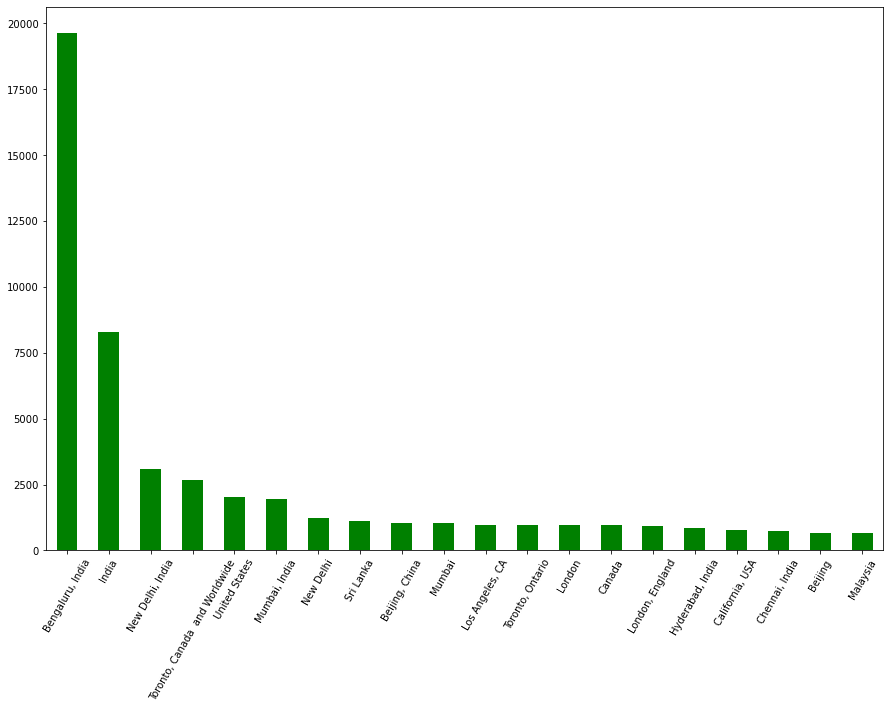

In [55]:
# Visulizing Tweet Count vs Location  
plt.figure(figsize=(15,10))
location_serie = data['user_location']
location_serie = location_serie.value_counts(dropna=True).nlargest(20)
location_serie.plot(kind ='bar', color='green')
plt.xticks(rotation=60)
plt.show()

In [56]:
data.source.value_counts()

Twitter for Android        58553
Twitter Web App            57050
Twitter for iPhone         49396
CowinAlertsBot             11276
cowin_vaccine_app          10203
                           ...  
Qnary.io                       1
Sociality.io                   1
ReadyForSocial App             1
Linky for iOS                  1
Africafrique Autotweets        1
Name: source, Length: 379, dtype: int64

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'Twitter for Android'),
  Text(1, 0, 'Twitter Web App'),
  Text(2, 0, 'Twitter for iPhone'),
  Text(3, 0, 'CowinAlertsBot'),
  Text(4, 0, 'cowin_vaccine_app'),
  Text(5, 0, 'Cowin Vaccination Availability')])

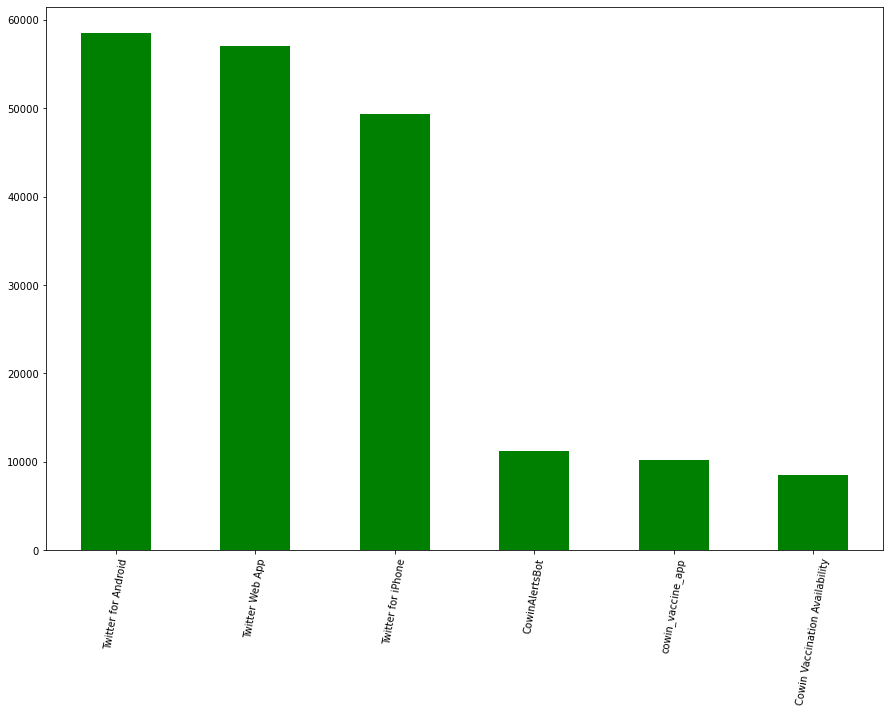

In [57]:
#Visualizing Tweet Platform-wise Distribution 
plt.figure(figsize=(15,10))
data['source'].value_counts().nlargest(6).plot(kind='bar',color='green')
plt.xticks(rotation=80)

<h3 style = "font-family: cursive;background-color:#ff99cc">Assigning Polarity & Subjectivity to tweets </h3>

In [58]:
lemmatizer = WordNetLemmatizer()
nltk.download('stopwords')
nltk.download('wordnet')

NameError: name 'nltk' is not defined

In [59]:
#stopwords are the words which won't bring about any changes to the polarity of the tweet
stop_words = stopwords.words('english')   
len(stop_words),stop_words[5:10]

(179, ['our', 'ours', 'ourselves', 'you', "you're"])

In [60]:
# function to remove stopwords
def stopWords(tweet):
  clean_tweet = tweet
  clean_tweet = " ".join(word for word in clean_tweet.split() if word not in stop_words)
# clean_tweet = " ".join(lemmatizer.lemmatize(word) for word in clean_tweet.split())
  return clean_tweet

In [61]:
data['text'] = data['text'].apply(lambda x: stopWords(x))

In [62]:
data.head(6)

,user_location,date,text,source
0,"La Crescenta-Montrose, CA",2020-12-20,Same folks said daikon paste could treat cytok...,Twitter for Android
1,"San Francisco, CA",2020-12-13,While world wrong side history year hopefully ...,Twitter Web App
2,Your Bed,2020-12-12,Russian vaccine created last 24 years,Twitter for Android
3,"Vancouver, BC - Canada",2020-12-12,Facts immutable Senator even youre ethically s...,Twitter Web App
4,NaN,2020-12-12,Explain need vaccine,Twitter for iPhone
5,"Birmingham, England",2020-12-12,Does anyone useful adviceguidance whether COVI...,Twitter for iPhone


In [63]:
# Function to assign polarity and subjectivity to the tweets
def blob_fun(text):
  senti = TextBlob(text)
  senti_polarity = senti.sentiment.polarity
  senti_subjectivity = senti.sentiment.subjectivity

  if senti_polarity > 0:
    res = 'Positive'

  elif senti_polarity < 0:
    res = 'Negative'

  elif senti_polarity == 0:
    res ="Neutral"

  result = {'polarity':senti_polarity,'subjectivity':senti_subjectivity,'sentiment':res}

  return result

In [64]:
blob_fun(data['text'][5])

{'polarity': 0.4, 'subjectivity': 0.25, 'sentiment': 'Positive'}

In [65]:
# but this isn't always right as shown in the example below
blob_fun('thank god,i tested negative for covid')

{'polarity': -0.3, 'subjectivity': 0.4, 'sentiment': 'Negative'}

In [66]:
data['results'] = data['text'].apply(blob_fun)
data.head(5)

,user_location,date,text,source,results
0,"La Crescenta-Montrose, CA",2020-12-20,Same folks said daikon paste could treat cytok...,Twitter for Android,"{'polarity': 0.0, 'subjectivity': 0.125, 'sent..."
1,"San Francisco, CA",2020-12-13,While world wrong side history year hopefully ...,Twitter Web App,"{'polarity': -0.5, 'subjectivity': 0.9, 'senti..."
2,Your Bed,2020-12-12,Russian vaccine created last 24 years,Twitter for Android,"{'polarity': 0.0, 'subjectivity': 0.0333333333..."
3,"Vancouver, BC - Canada",2020-12-12,Facts immutable Senator even youre ethically s...,Twitter Web App,"{'polarity': 0.1, 'subjectivity': 0.55, 'senti..."
4,NaN,2020-12-12,Explain need vaccine,Twitter for iPhone,"{'polarity': 0.0, 'subjectivity': 0.0, 'sentim..."


In [67]:
data = data.join(pd.json_normalize(data=data['results']))

In [68]:
data.head()

,user_location,date,text,source,results,polarity,subjectivity,sentiment
0,"La Crescenta-Montrose, CA",2020-12-20,Same folks said daikon paste could treat cytok...,Twitter for Android,"{'polarity': 0.0, 'subjectivity': 0.125, 'sent...",0.0,0.125000,Neutral
1,"San Francisco, CA",2020-12-13,While world wrong side history year hopefully ...,Twitter Web App,"{'polarity': -0.5, 'subjectivity': 0.9, 'senti...",-0.5,0.900000,Negative
2,Your Bed,2020-12-12,Russian vaccine created last 24 years,Twitter for Android,"{'polarity': 0.0, 'subjectivity': 0.0333333333...",0.0,0.033333,Neutral
3,"Vancouver, BC - Canada",2020-12-12,Facts immutable Senator even youre ethically s...,Twitter Web App,"{'polarity': 0.1, 'subjectivity': 0.55, 'senti...",0.1,0.550000,Positive
4,NaN,2020-12-12,Explain need vaccine,Twitter for iPhone,"{'polarity': 0.0, 'subjectivity': 0.0, 'sentim...",0.0,0.000000,Neutral


In [69]:
# categorized tweets in seperate Series
positive_tweet =  data[data['sentiment'] == 'Positive']['text']
negative_tweet =  data[data['sentiment'] == 'Negative']['text']
neutral_tweet =  data[data['sentiment'] == 'Neutral']['text']

In [70]:
from wordcloud import WordCloud
# Function for creating WordClouds
def cloud_of_Words(tweet_cat,title):
    forcloud = ' '.join([tweet for tweet in tweet_cat])
    wordcloud = WordCloud(width =500,height = 300,random_state =5,max_font_size=110).generate(forcloud)
    plt.imshow(wordcloud, interpolation ='bilinear')
    plt.title(title)
    plt.axis('off')
    plt.show()
    plt.figure(figsize = (10,8))

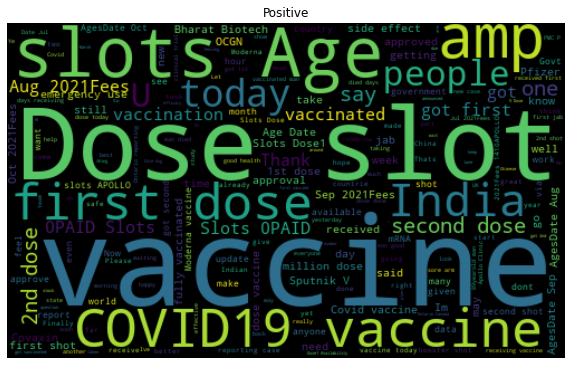

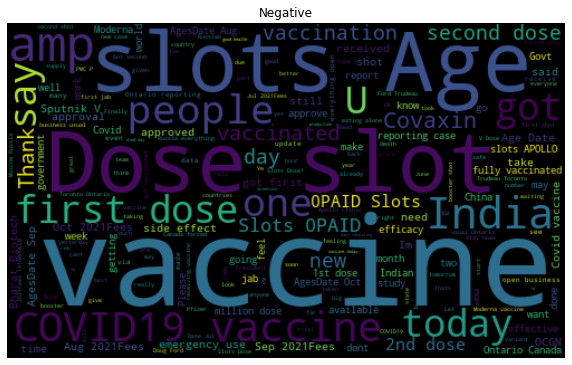

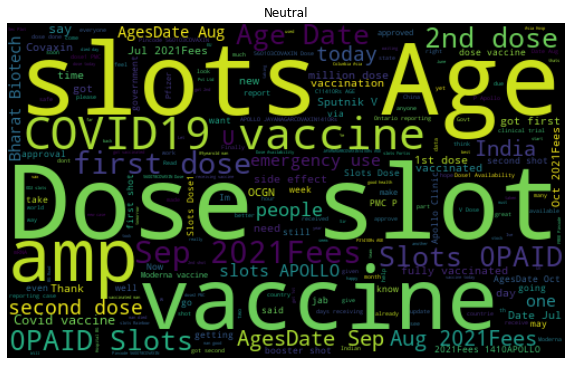

<Figure size 720x576 with 0 Axes>

In [71]:
plt.figure(figsize = (10,8))
# Creating wordclouds for positive, negative, neutral tweets
cloud_of_Words(positive_tweet, 'Positive')
cloud_of_Words(negative_tweet, 'Negative')
cloud_of_Words(neutral_tweet, 'Neutral')

**Observation**
- The above three wordclouds have the similar words as expected because our main analysis is Covid Vaccine

In [72]:
# Breaking down the tweets into words in seperate categories
positive_tokens = [token for line in positive_tweet for token in line.split()]
negative_tokens = [token for line in negative_tweet for token in line.split()]
neutral_tokens = [token for line in neutral_tweet for token in line.split()]

In [73]:
# to get most used words
def get_maxtoken(tweets,num=30):
  word_tokens = Counter(tweets)
  max_common = word_tokens.most_common(num)
  return dict(max_common)

In [74]:
def token_df_vis(x, title):
  df = pd.DataFrame(get_maxtoken(x).items(),columns=['words','count'])
  # plt.figure(figsize = (20,5))
  # plt.title(title)
  # plt.xticks(rotation=45)
  fig = px.bar(df,x='words',y='count',title = title)
  fig.show()

In [75]:
token_df_vis(positive_tokens,'Positive')
token_df_vis(negative_tokens,'Negative')
token_df_vis(neutral_tokens,'Neutral')

In [76]:
fig = px.scatter(data,x='polarity',y='subjectivity')
fig.show()

Shows the spread of our tweets on polarity vs subjectivity 

In [77]:
def percent(x,y):
  return print("Percentage of "+y+" tweets :",round(len(x)/data.shape[0]*100,3),"%")

In [78]:
percent(positive_tweet, 'positive')
percent(negative_tweet, 'negative')
percent(neutral_tweet, 'neutral')

Percentage of positive tweets : 30.366 %
Percentage of negative tweets : 9.824 %
Percentage of neutral tweets : 59.001 %


<AxesSubplot:>

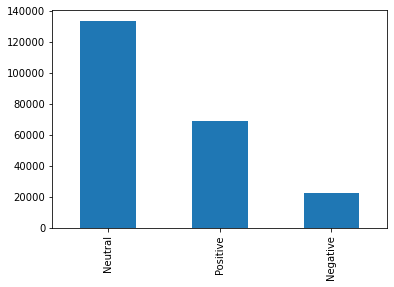

In [79]:
data['sentiment'].value_counts().plot(kind='bar')

<h2 style = "font-family: cursive;background-color:#ff99cc">Vaccine-wise analysis </h2>

In [80]:
data.columns

Index(['user_location', 'date', 'text', 'source', 'results', 'polarity',
       'subjectivity', 'sentiment'],
      dtype='object')

In [81]:
deep = data.drop(columns="results")
deep.head(6)

,user_location,date,text,source,polarity,subjectivity,sentiment
0,"La Crescenta-Montrose, CA",2020-12-20,Same folks said daikon paste could treat cytok...,Twitter for Android,0.0,0.125000,Neutral
1,"San Francisco, CA",2020-12-13,While world wrong side history year hopefully ...,Twitter Web App,-0.5,0.900000,Negative
2,Your Bed,2020-12-12,Russian vaccine created last 24 years,Twitter for Android,0.0,0.033333,Neutral
3,"Vancouver, BC - Canada",2020-12-12,Facts immutable Senator even youre ethically s...,Twitter Web App,0.1,0.550000,Positive
4,NaN,2020-12-12,Explain need vaccine,Twitter for iPhone,0.0,0.000000,Neutral
5,"Birmingham, England",2020-12-12,Does anyone useful adviceguidance whether COVI...,Twitter for iPhone,0.4,0.250000,Positive


In [82]:
# creating reference tags for 5 vaccines -> Pfizer, Covaxin(Bharat Biotech), Sputnik,AstraZenca(Covishield),Moderna
pfizer_refs = ["Pfizer","pfizer","Pfizer–BioNTech","pfizer-bioNtech","BioNTech","biontech"]
bbiotech_refs = ["covax","covaxin","Covax","Covaxin","Bharat Biotech","bharat biotech","BharatBiotech","bharatbiotech"]
sputnik_refs = ["russia","sputnik","Sputnik","V"]
astra_refs = ['sii','SII','adar poonawalla','Covishield','covishield','astra','zenca','Oxford–AstraZeneca','astrazenca','oxford-astrazenca','serum institiute']
moderna_refs = ['moderna','Moderna','mRNA-1273','Spikevax']

In [83]:
def refer(tweet, refs):
  flag =0
  for ref in refs:
    if tweet.find(ref) != -1:
      flag =1
  return flag

deep['pfizer'] = deep['text'].apply(lambda x : refer(x, pfizer_refs))
deep['bbiotech'] = deep['text'].apply(lambda x : refer(x, bbiotech_refs))
deep['sputnik'] = deep['text'].apply(lambda x : refer(x, sputnik_refs))
deep['astra'] = deep['text'].apply(lambda x : refer(x, astra_refs))
deep['moderna'] = deep['text'].apply(lambda x : refer(x, moderna_refs))

In [84]:
print(deep.pfizer.value_counts(),
        deep.bbiotech.value_counts(),
        deep.sputnik.value_counts(),
        deep.astra.value_counts(),
        deep.moderna.value_counts())

0    222795
1      3578
Name: pfizer, dtype: int64 0    218920
1      7453
Name: bbiotech, dtype: int64 0    180256
1     46117
Name: sputnik, dtype: int64 0    225304
1      1069
Name: astra, dtype: int64 0    219603
1      6770
Name: moderna, dtype: int64


In [85]:
deep[deep['bbiotech']==1].head()    #what the dataset looks like

,user_location,date,text,source,polarity,subjectivity,sentiment,pfizer,bbiotech,sputnik,astra,moderna
1592,NaN,2020-12-26,The country part Gavi Vaccine Alliance oversee...,TweetDeck,0.000000,0.000000,Neutral,0,1,1,0,0
2202,NaN,2021-01-03,India approves AstraZeneca Bharat Biotech vacc...,TweetDeck,0.000000,0.000000,Neutral,1,1,0,0,0
2383,"New Delhi, India",2021-01-05,Covid19 Vaccine War Covaxin Maker Bharat Biote...,Twitter Web App,0.500000,0.500000,Positive,0,1,1,0,0
4138,India,2021-01-21,Covishield vs Covaxin vs ModernaPfizer Science...,Twitter for Android,0.227273,0.545455,Positive,1,1,1,1,1
5399,INDIA/ BHARAT.,2021-02-07,Dr Bharat Biotech Signs US Partner IndiaApprov...,Twitter for Android,0.000000,0.000000,Neutral,0,1,1,0,0


In [86]:
deep[deep['pfizer']==1].head()

,user_location,date,text,source,polarity,subjectivity,sentiment,pfizer,bbiotech,sputnik,astra,moderna
23,"Mumbai, India",2020-12-12,The US Food Drug Administration FDA granted em...,Twitter Web App,0.00,0.000000,Neutral,1,0,0,0,0
66,NaN,2020-12-14,ICU nurse Sandra Lindsay said proud becoming o...,Twitter Media Studio,0.50,0.727778,Positive,1,0,0,0,0
88,"Beaumont, Texas",2020-12-14,KFDMsFOX 4s Baptist hospital getting first han...,Twitter for iPhone,0.25,0.333333,Positive,1,0,1,0,0
94,India,2020-12-14,Toronto receive Ontarios 1st doses Pfizer COVI...,Twitter Web App,0.00,0.000000,Neutral,1,0,1,0,0
98,NaN,2020-12-14,The FDA Authorizes Emergency Use Of The Pfizer...,Twitter Web App,0.00,0.000000,Neutral,1,0,1,0,0


In [87]:
def stats(a,b,c,d,e):
  for i in a,b,c,d,e:
     display(deep[deep[i]==1][[i,'polarity','subjectivity']].groupby(i).agg([np.mean,np.max,np.min,np.median]))

In [88]:
stats('pfizer','bbiotech','sputnik','astra','moderna')

polarity                  subjectivity                 
            mean amax amin median         mean amax amin median
pfizer                                                         
1       0.081672  1.0 -1.0    0.0     0.226766  1.0  0.0    0.0

polarity                  subjectivity                 
              mean amax amin median         mean amax amin median
bbiotech                                                         
1         0.078561  1.0 -1.0    0.0     0.218091  1.0  0.0    0.0

polarity                  subjectivity                 
             mean amax amin median         mean amax amin median
sputnik                                                         
1        0.071698  1.0 -1.0    0.0     0.211629  1.0  0.0    0.0

polarity                  subjectivity                 
           mean amax amin median         mean amax amin median
astra                                                         
1      0.080196  1.0 -1.0    0.0     0.221604  1.0  0.0    0.0

polarity                  subjectivity                 
             mean amax amin median         mean amax amin median
moderna                                                         
1        0.081975  1.0 -1.0    0.0     0.232583  1.0  0.0    0.0

In [89]:
pfizer = deep[deep['pfizer']==1][['date','polarity']]
bbiotech = deep[deep['bbiotech']==1][['date','polarity']]
sputnik = deep[deep['sputnik']==1][['date','polarity']]
astra = deep[deep['astra']==1][['date','polarity']]
moderna = deep[deep['moderna']==1][['date','polarity']]

pfizer = pfizer.sort_values(by='date',ascending=True)
bbiotech = bbiotech.sort_values(by='date',ascending=True)
sputnik = sputnik.sort_values(by='date',ascending=True)
astra = astra.sort_values(by='date',ascending=True)
moderna = moderna.sort_values(by='date',ascending=True)

pfizer['Avg Polarity'] = pfizer.polarity.rolling(20, min_periods=3).mean()
bbiotech['Avg Polarity'] = bbiotech.polarity.rolling(20, min_periods=3).mean()
sputnik['Avg Polarity'] = sputnik.polarity.rolling(20, min_periods=3).mean()
astra['Avg Polarity'] = astra.polarity.rolling(5, min_periods=3).mean()
moderna['Avg Polarity'] = moderna.polarity.rolling(20, min_periods=3).mean()

In [90]:
bbiotech.head(10)

,date,polarity,Avg Polarity
1592,2020-12-26,0.000000,NaN
2202,2021-01-03,0.000000,NaN
2383,2021-01-05,0.500000,0.166667
4138,2021-01-21,0.227273,0.181818
5399,2021-02-07,0.000000,0.145455
5401,2021-02-07,0.300000,0.171212
5629,2021-02-07,0.500000,0.218182
5630,2021-02-07,0.000000,0.190909
5840,2021-02-08,0.800000,0.258586
6068,2021-02-08,0.000000,0.232727


<h2 style = "font-family: cursive;background-color:#ff99cc">Vaccine Polarity vs Time </h2>

In [91]:
a,b,c,d,e = pfizer,bbiotech,sputnik,astra,moderna
fig = px.line(a, x="date", y="Avg Polarity", title='Pfizer')
fig.show()
fig = px.line(b, x="date", y="Avg Polarity", title='Bharat Biotech')
fig.show()
fig = px.line(c, x="date", y="Avg Polarity", title='Sputnik')
fig.show()
fig = px.line(d, x="date", y="Avg Polarity", title='AstraZence/Covishield')
fig.show()
fig = px.line(e, x="date", y="Avg Polarity", title='Moderna')
fig.show()

<h2 style = "font-family: cursive;background-color:#ff99cc">Overall Vaccine Polarity</h2>

In [92]:
total=pd.DataFrame()
total['date'] = sorted(deep['date'].unique())
senti=list()
for date in total['date']:
    senti.append(deep[deep['date']==date].polarity.mean())
total['Sentiment']=senti
fig = px.line(total, x="date", y="Sentiment", title='Overall Sentiment around Vaccines')
fig.show()   